In [1]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers



2023-07-18 12:11:41.360384: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-07-18 12:11:41.471259: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-07-18 12:11:41.472721: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-18 12:11:42.344150: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [2]:

import os

num_skipped = 0
for folder_name in ("clear", "cloudy"):
    folder_path = os.path.join("img/train", folder_name)
    for fname in os.listdir(folder_path):
        fpath = os.path.join(folder_path, fname)
        try:
            fobj = open(fpath, "rb")
            is_jfif = tf.compat.as_bytes("PNG") in fobj.peek(10)
        finally:
            fobj.close()

        if not is_jfif:
            num_skipped += 1
            # Delete corrupted image
            os.remove(fpath)

print("Deleted %d images" % num_skipped)


Deleted 0 images


In [3]:

image_size = (544, 512)
batch_size = 32

train_ds, val_ds = tf.keras.utils.image_dataset_from_directory(
    "img/train",
    validation_split=0.2,
    subset="both",
    seed=1337,
    image_size=image_size,
    batch_size=batch_size,
)


Found 2977 files belonging to 2 classes.
Using 2382 files for training.
Using 595 files for validation.


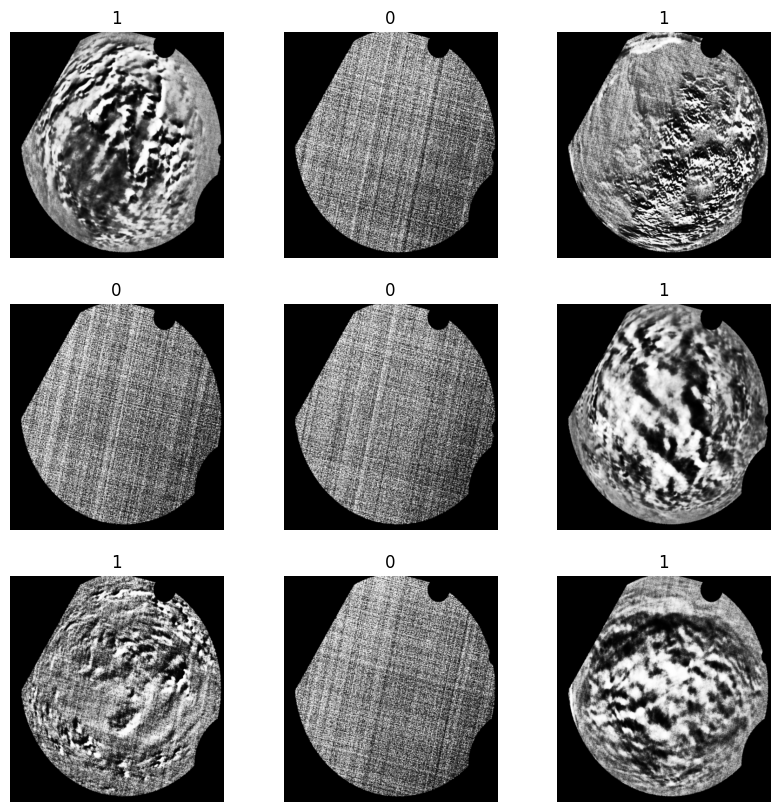

In [4]:

import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(int(labels[i]))
        plt.axis("off")


In [7]:
data_augmentation = keras.Sequential(
    [
#        layers.RandomFlip("horizontal"),
#        layers.RandomRotation(0.1),
    ]
)


In [8]:
train_ds = train_ds.map(
    lambda img, label: (data_augmentation(img), label),
    num_parallel_calls=tf.data.AUTOTUNE,
)
# Prefetching samples in GPU memory helps maximize GPU utilization.
train_ds = train_ds.prefetch(tf.data.AUTOTUNE)
val_ds = val_ds.prefetch(tf.data.AUTOTUNE)

In [9]:

def make_model(input_shape, num_classes):
    inputs = keras.Input(shape=input_shape)

    # Entry block
    x = layers.Rescaling(1.0 / 255)(inputs)
#    x = layers.Conv2D(128, 3, strides=2, padding="same")(x)
    x = layers.Conv2D(32, 3, strides=2, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation("relu")(x)

    previous_block_activation = x  # Set aside residual

#    for size in [256, 512, 728]:
#        x = layers.Activation("relu")(x)
#        x = layers.SeparableConv2D(size, 3, padding="same")(x)
#        x = layers.BatchNormalization()(x)

#        x = layers.Activation("relu")(x)
#        x = layers.SeparableConv2D(size, 3, padding="same")(x)
#        x = layers.BatchNormalization()(x)

#        x = layers.MaxPooling2D(3, strides=2, padding="same")(x)

        # Project residual
#        residual = layers.Conv2D(size, 1, strides=2, padding="same")(
#            previous_block_activation
#        )
#        x = layers.add([x, residual])  # Add back residual
#        previous_block_activation = x  # Set aside next residual

#    x = layers.SeparableConv2D(1024, 3, padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation("relu")(x)

    x = layers.GlobalAveragePooling2D()(x)
    if num_classes == 2:
        activation = "sigmoid"
        units = 1
    else:
        activation = "softmax"
        units = num_classes

    x = layers.Dropout(0.5)(x)
    outputs = layers.Dense(units, activation=activation)(x)
    return keras.Model(inputs, outputs)


model = make_model(input_shape=image_size + (3,), num_classes=2)

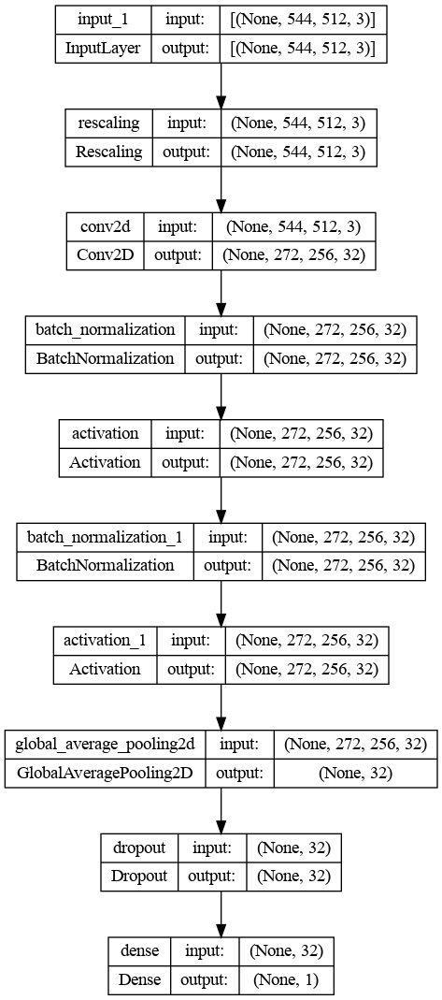

In [10]:
keras.utils.plot_model(model, show_shapes=True)


In [11]:

epochs = 10

callbacks = [
    keras.callbacks.ModelCheckpoint("save_at_{epoch}.keras"),
]
model.compile(
    optimizer=keras.optimizers.Adam(1e-3),
    loss="binary_crossentropy",
    metrics=["accuracy"],
)

In [12]:
model.fit(
    train_ds,
    epochs=epochs,
    callbacks=callbacks,
    validation_data=val_ds,
)


Epoch 1/10
75/75 [==============================] - 77s 1s/step - loss: 0.5700 - accuracy: 0.6814 - val_loss: 0.6671 - val_accuracy: 0.5345
Epoch 2/10
75/75 [==============================] - 84s 1s/step - loss: 0.3914 - accuracy: 0.9165 - val_loss: 0.6502 - val_accuracy: 0.5345
Epoch 3/10
75/75 [==============================] - 84s 1s/step - loss: 0.3197 - accuracy: 0.9425 - val_loss: 0.6336 - val_accuracy: 0.5345
Epoch 4/10
75/75 [==============================] - 78s 1s/step - loss: 0.2681 - accuracy: 0.9488 - val_loss: 0.6115 - val_accuracy: 0.5345
Epoch 5/10
75/75 [==============================] - 77s 1s/step - loss: 0.2091 - accuracy: 0.9681 - val_loss: 0.5820 - val_accuracy: 0.5345
Epoch 6/10
75/75 [==============================] - 76s 1s/step - loss: 0.1744 - accuracy: 0.9757 - val_loss: 0.5078 - val_accuracy: 0.5361
Epoch 7/10
75/75 [==============================] - 77s 1s/step - loss: 0.1462 - accuracy: 0.9815 - val_loss: 0.3695 - val_accuracy: 1.0000
Epoch 8/10
75/75 [==

1/1 [==============================] - 0s 24ms/step


/tmp/ipykernel_317703/1079563972.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(1, 1))


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 19ms/step


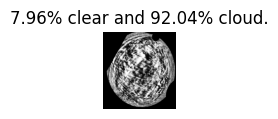

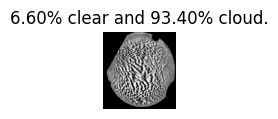

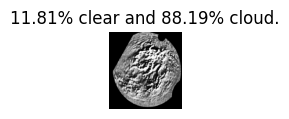

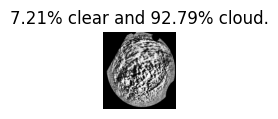

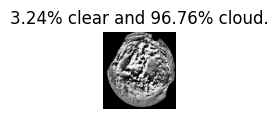

...

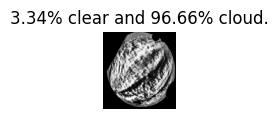

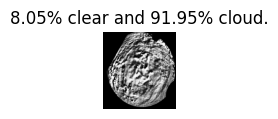

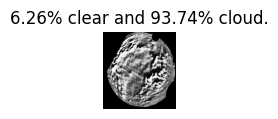

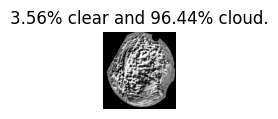

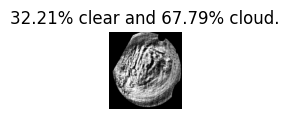

In [21]:
import glob
for i in glob.glob("img/val/cloudy/*.png"):
    img = keras.utils.load_img(i, target_size=image_size)
    img_array = keras.utils.img_to_array(img)
    img_array = tf.expand_dims(img_array, 0)  # Create batch axis

    predictions = model.predict(img_array)
    score = float(predictions[0])
#    print(f"{i} is {100 * (1 - score):.2f}% clear and {100 * score:.2f}% cloud.")
    
    plt.figure(figsize=(1, 1))
    plt.imshow(img)
    plt.title(f"{100 * (1 - score):.2f}% clear and {100 * score:.2f}% cloud.")
    plt.axis("off")

